In [28]:
import numpy as np
import matplotlib.pyplot as plt
from numpy.fft import fft2, ifft2, fftshift

%matplotlib notebook

# Making a Gaussian random field in the Fourier domain with FFTs

Reference: https://garrettgoon.com/gaussian-fields/, https://mathematica.stackexchange.com/questions/4829/efficiently-generating-n-d-gaussian-random-fields

Build $k_a = 2 \pi / N \, (0, 1, \ldots, N/2, -N/2 + 1, \ldots, -1) $ for and even $N$:

In [29]:
N = 200

idxs = np.concatenate((np.arange(N / 2 + 1), np.arange(-N / 2 + 1, 0)))
print(idxs[:3], '...', idxs[-3:])
ka = 2 * np.pi / N * idxs[:, np.newaxis]
    
print(ka.shape)

[0. 1. 2.] ... [-3. -2. -1.]
(200, 1)


Make function for the power spectrum $P(k) \propto k^{-n} $, accounting for the divide by zero error:

In [30]:
def power_law(k, n):
    # condition, true replacement, false replacement
    with np.errstate(divide='ignore'):
        return np.where(k > 0, k ** (-n), 0.0)

Evaluate this at all $(k_a, k_b)$ with $k = ||(k_a, k_b)||$

<IPython.core.display.Javascript object>


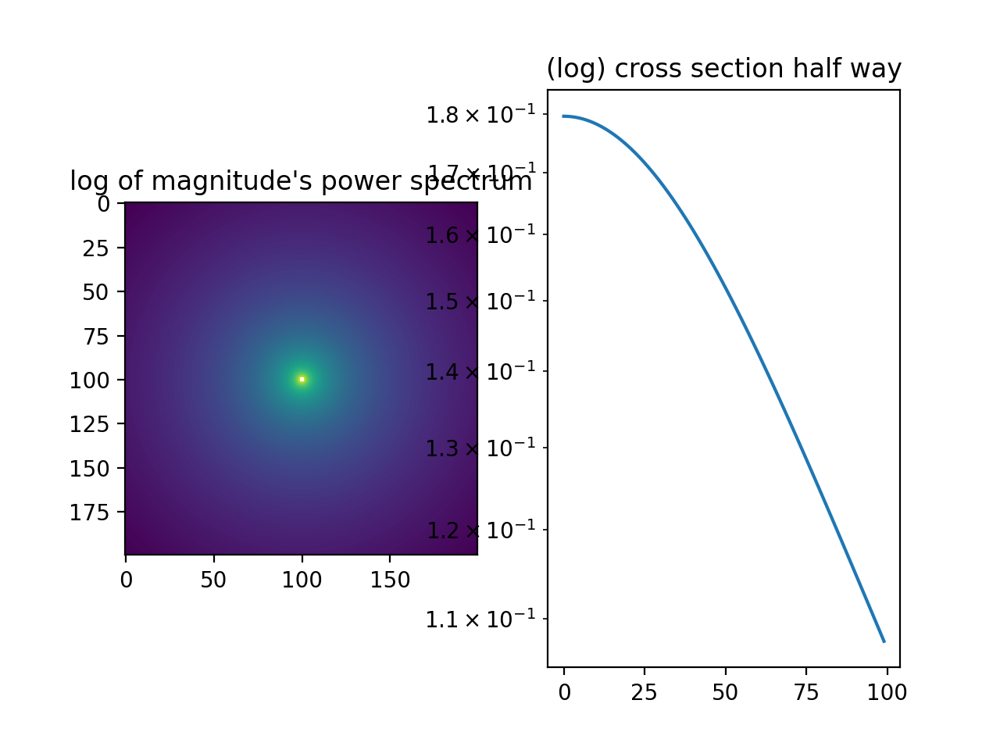

<ipython-input-31-77e1359e7677>:6: RuntimeWarning: divide by zero encountered in log
  axes[0].imshow(fftshift(np.log(P)))


Text(0.5, 1.0, '(log) cross section half way')

In [31]:
# Fig 4.32 Hanssen seems to combine different powers at different scales
karr = np.sqrt(ka ** 2 + ka.T ** 2)
P = np.sqrt(power_law(karr, 3))

fig, axes = plt.subplots(1, 2)
axes[0].imshow(fftshift(np.log(P)))
axes[0].set_title("log of magnitude's power spectrum")
axes[1].semilogy(P[N//2, :N//2])
axes[1].set_title("(log) cross section half way")


In [32]:
white_noise = np.random.uniform(size=(N, N))
w_hat = fft2(white_noise)
Phi = w_hat * P
phi = ifft2(w_hat * P).real

<IPython.core.display.Javascript object>


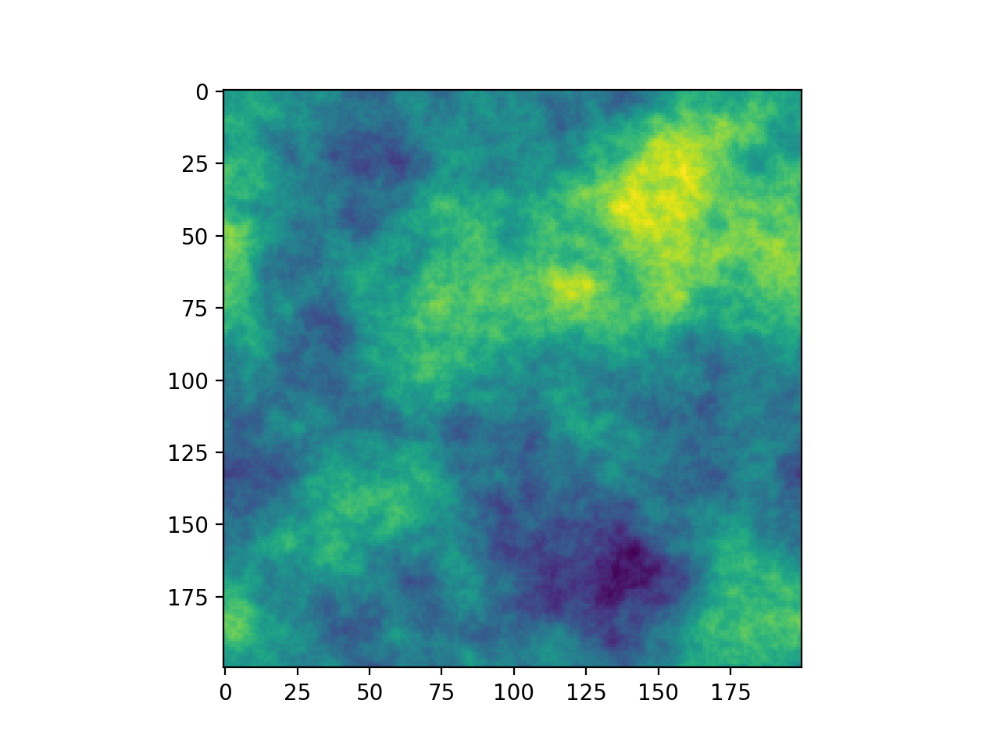

In [33]:
fig, ax = plt.subplots()
ax.imshow(phi)

Now as one function:

In [44]:
def make_gaussian_field(Nsize, n=3, seed=None):
    if seed is not None:
        np.random.seed(seed)
    white_noise = np.random.uniform(size=(Nsize, Nsize))
    w_hat = fft2(white_noise)
    idxs = np.concatenate((np.arange(Nsize / 2 + 1), np.arange(-Nsize / 2 + 1, 0)))
    ka = 2 * np.pi / Nsize * idxs[:, np.newaxis]
    karr = np.sqrt(ka ** 2 + ka.T ** 2)
    P = np.sqrt(power_law(karr, n))

    Phi = w_hat * P
    return ifft2(Phi).real

# Notes from Hanssen 

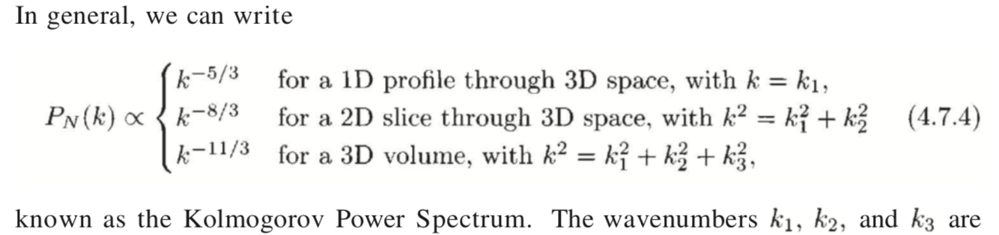

TODO:
- Kolmogorov Power Spectrum
- Define: structure function
https://en.wikipedia.org/wiki/Kolmogorov_structure_function


<IPython.core.display.Javascript object>


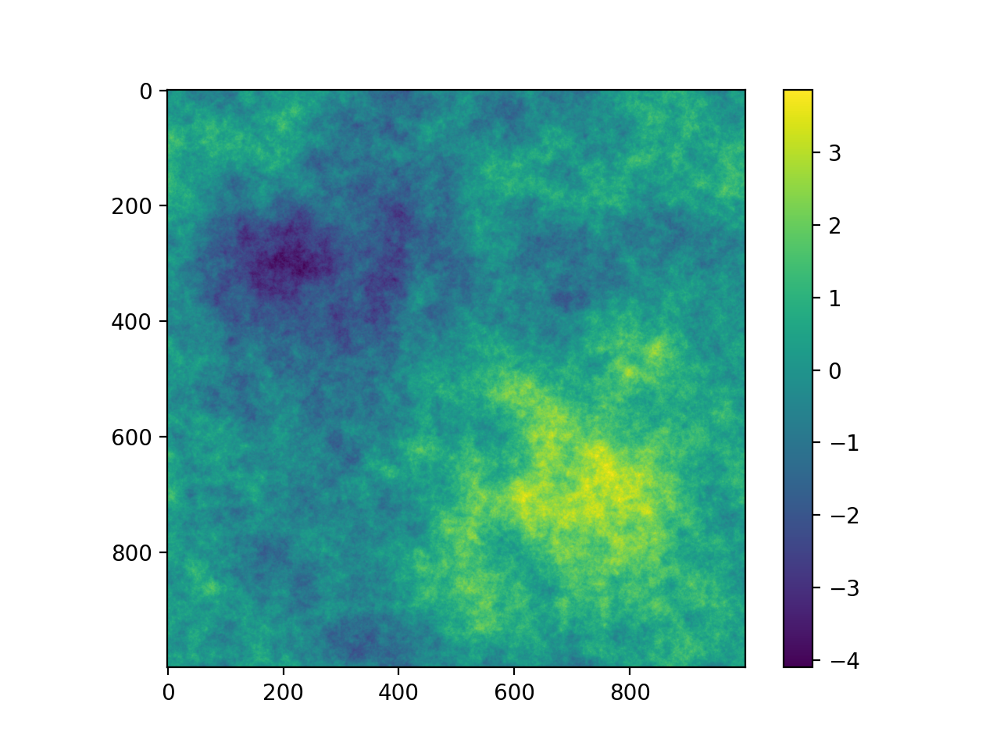

In [48]:
fig, ax = plt.subplots()
phi = make_gaussian_field(1000, 8/3, seed=0)
axim = ax.imshow(phi)
fig.colorbar(axim, ax=ax);

In [36]:
# https://www.stt.msu.edu/~xiaoyimi/RecentProgress_Revised.pdf

def plot_fractal(N, power, nzoom=4, cmap=None):
    img = make_gaussian_field(N, power)
    nrow = int(np.floor(np.sqrt(nzoom)))
    ncol = int(np.ceil(nzoom / nrow))
    fig, axes = plt.subplots(nrow, ncol)
    cur_img = img
    n = N
    for idx, ax in enumerate(axes.ravel()):
        ax.imshow(cur_img, cmap=cmap)
        cur_img = cur_img[:n//2, :n//2]
        n = n // 2

<IPython.core.display.Javascript object>


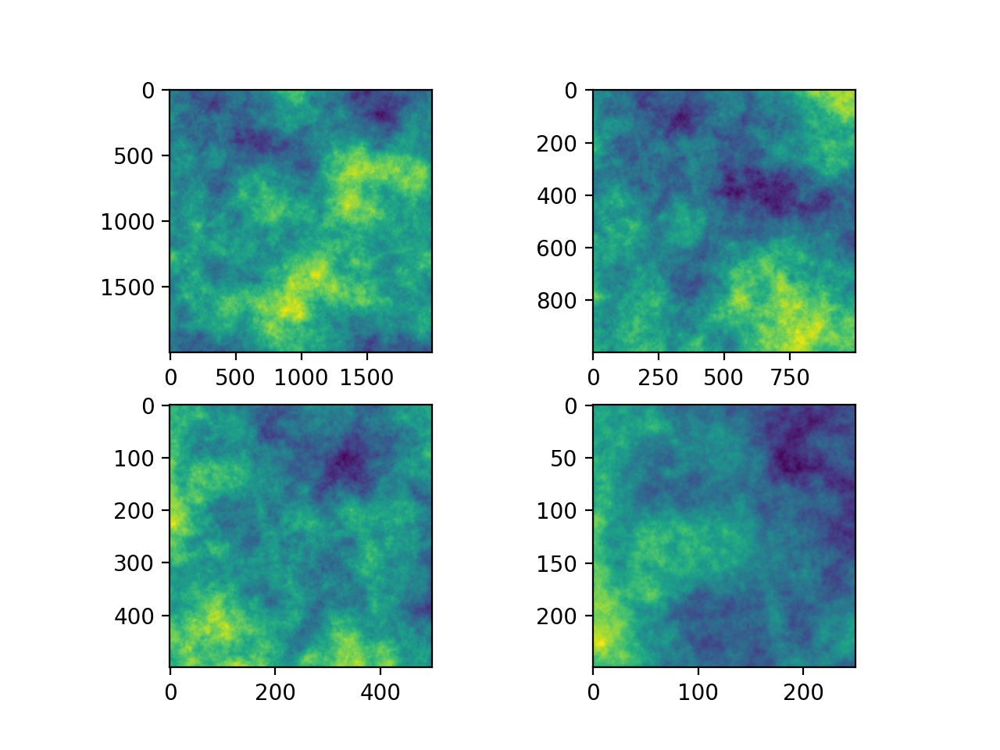

In [37]:
plot_fractal(2000, 3, nzoom=4)

### TODO
- Why fractal?
- why power law?
- plot power law of cross section
- verify this is same as MintPy code?
- how to fit and estimate the params from real data?

In [38]:
from mintpy.simulation import fractal

<IPython.core.display.Javascript object>


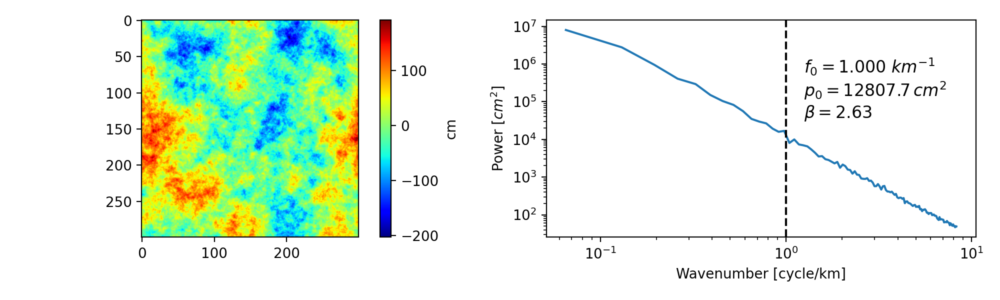

p0 = 1.280773641307478
beta_true - beta =0.03969048797921193


In [49]:
beta_true = 8/3
phi = make_gaussian_field(300, 8/3, seed=0)
p0, beta, freq, psd1d = fractal.get_power_spectral_density(phi, display=True)
print(f"{p0 = }")
print(f"{beta_true - beta =}")

In [59]:
import ipyvolume as ipv
import numpy as np

# x, y, z, u, v, w = np.random.random((6, 1000))*2-1
# selected = np.random.randint(0, 1000, 100)
# ipv.figure()
# quiver = ipv.quiver(x, y, z, u, v, w, size=5, size_selected=8, selected=selected)

# import ipywidgets
# from ipywidgets import FloatSlider, ColorPicker, VBox, jslink
# size = FloatSlider(min=0, max=30, step=0.1)
# size_selected = FloatSlider(min=0, max=30, step=0.1)
# color = ColorPicker()
# color_selected = ColorPicker()
# jslink((quiver, 'size'), (size, 'value'))
# jslink((quiver, 'size_selected'), (size_selected, 'value'))
# jslink((quiver, 'color'), (color, 'value'))
# jslink((quiver, 'color_selected'), (color_selected, 'value'))
# vb = VBox([ipv.gcc(), size, size_selected, color, color_selected])

In [72]:
phi_stack = np.array([make_gaussian_field(300, beta, seed=0) for beta in np.arange(0, 3.5, .5)])
phi = phi_stack[-1]
p0, beta, freq, psd1d = fractal.get_power_spectral_density(phi)

resolution = 1
xx = resolution * np.arange(phi.shape[0])
Kx, Ky = np.meshgrid(xx, xx)

from matplotlib import cm
colormap = cm.coolwarm
znorm = phi - phi.min()
znorm /= znorm.ptp()
znorm.min(), znorm.max()
color = colormap(znorm)

In [74]:
ipv.figure()
mesh = ipv.plot_surface(Kx, Ky, phi_stack, color=color[...,:3])
ipv.animation_control(mesh) # shows controls for animation controls
# ipv.show()
vb = VBox([ipv.gcc()])

In [75]:
# ipywidgets.embed.embed_minimal_html('widget_min.html', views=[ipv.gcc(), quiver, size, size_selected, color])
# ipywidgets.embed.embed_minimal_html?
# ipv.embed.embed_html("widget1.html", [vb, quiver])
ipv.embed.embed_html("widget1.html", [vb])
# ipv.embed.embed_html
# type(quiver)

In [76]:
from IPython.core.display import HTML
with open("widget1.html") as f:
    wt = f.read()
display(HTML(wt))
# HTML(wt)